Importacion de librerias


In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler
import seaborn as sns
from imblearn.under_sampling import RandomUnderSampler
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

Lectura de dataset

In [2]:
data=pd.read_csv('./Inputs/data_logistic_regression.csv')

Analisis Exploratorio de Datos

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [4]:
data.drop(['Unnamed: 32'],axis=1,inplace=True)

In [5]:
data.drop_duplicates(inplace=True)

In [6]:
data.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [7]:
data['diagnosis'].unique()

array(['M', 'B'], dtype=object)

Balanceo de los datos

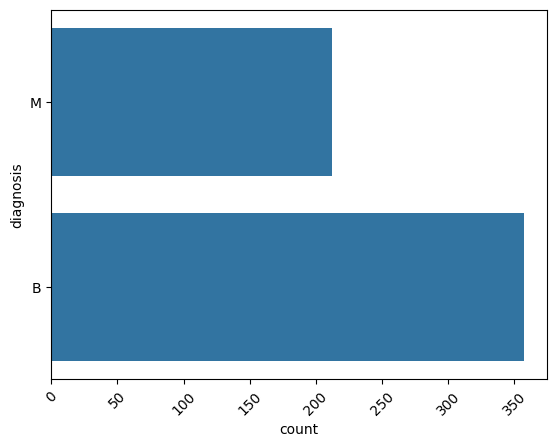

In [12]:
sns.countplot(data.diagnosis)
plt.xticks(rotation=45)
plt.show()

In [13]:
from imblearn.under_sampling import RandomUnderSampler
undersample = RandomUnderSampler(random_state=42)
X=data.drop(['id','diagnosis'],axis=1)
y=data['diagnosis']

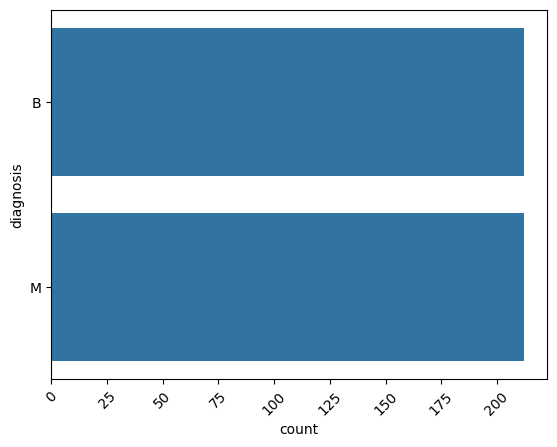

In [14]:
X_over , y_over = undersample.fit_resample(X,y)
sns.countplot(y_over)
plt.xticks(rotation=45)
plt.show()

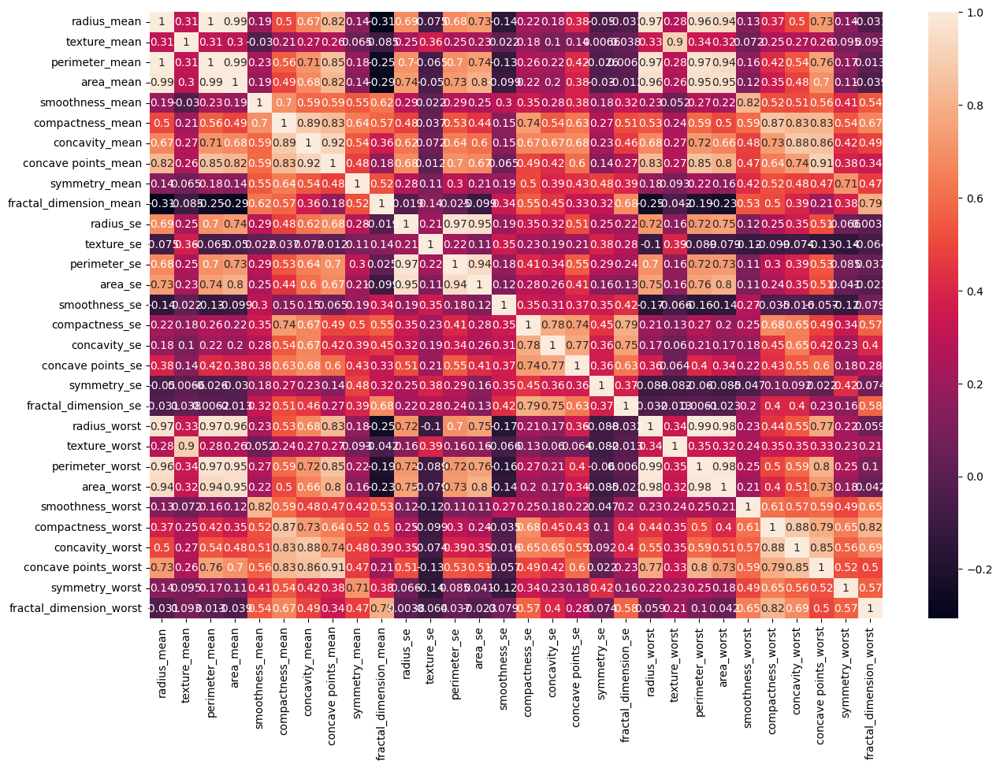

In [15]:
plt.figure(figsize=(18,12))
sns.heatmap(X_over.corr(), annot=True)
plt.show()

In [32]:
X.columns

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

Eliminacion de variables para evitar multicolinealidad

In [16]:
X_over.drop(['perimeter_mean','radius_mean','perimeter_worst','radius_worst','perimeter_se','radius_se'],inplace=True,axis=1)

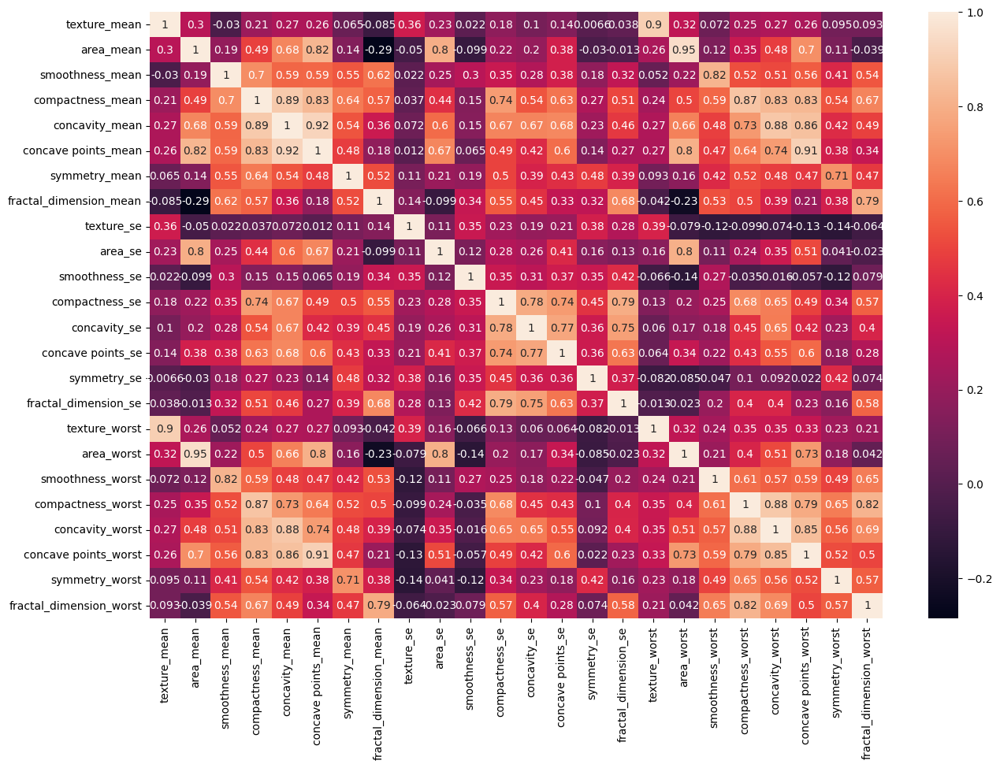

In [17]:
plt.figure(figsize=(15,10))
sns.heatmap(X_over.corr(), annot=True)
plt.show()

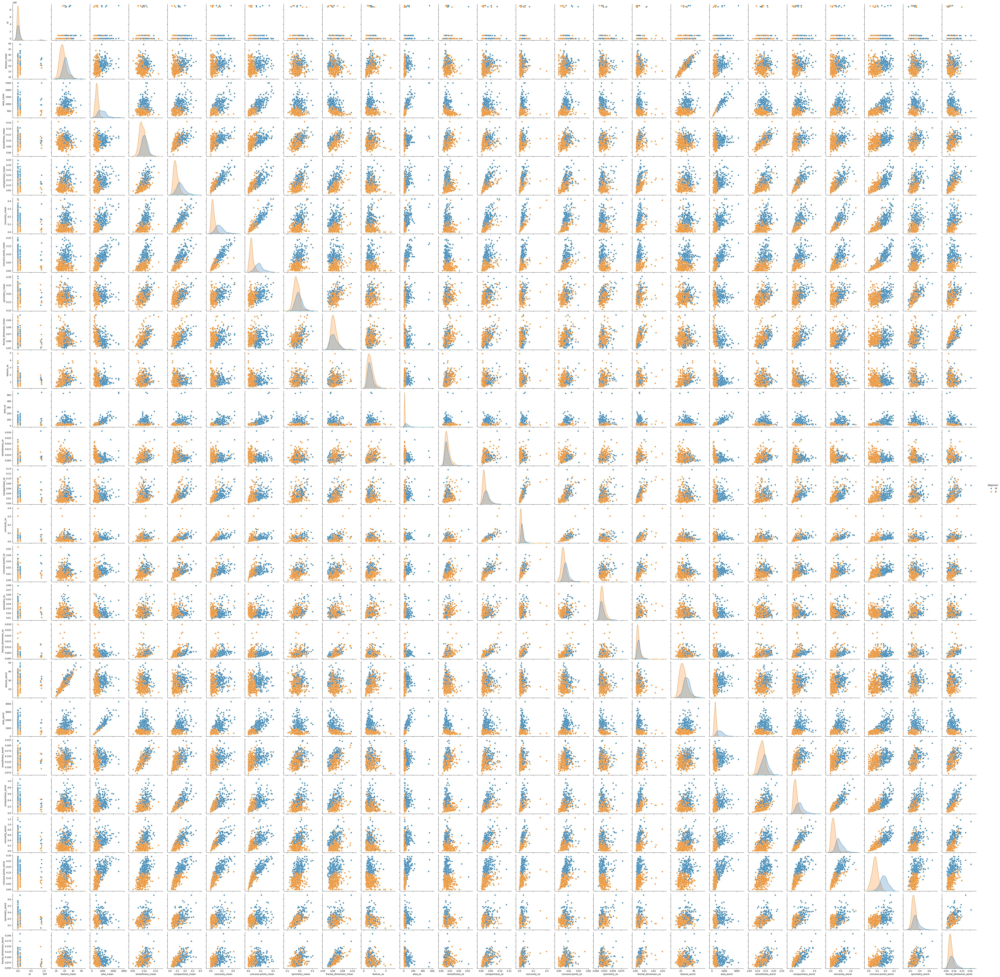

In [18]:
data.drop(['perimeter_mean','radius_mean','perimeter_worst','radius_worst','perimeter_se','radius_se'],inplace=True,axis=1)


<Figure size 1500x1000 with 0 Axes>

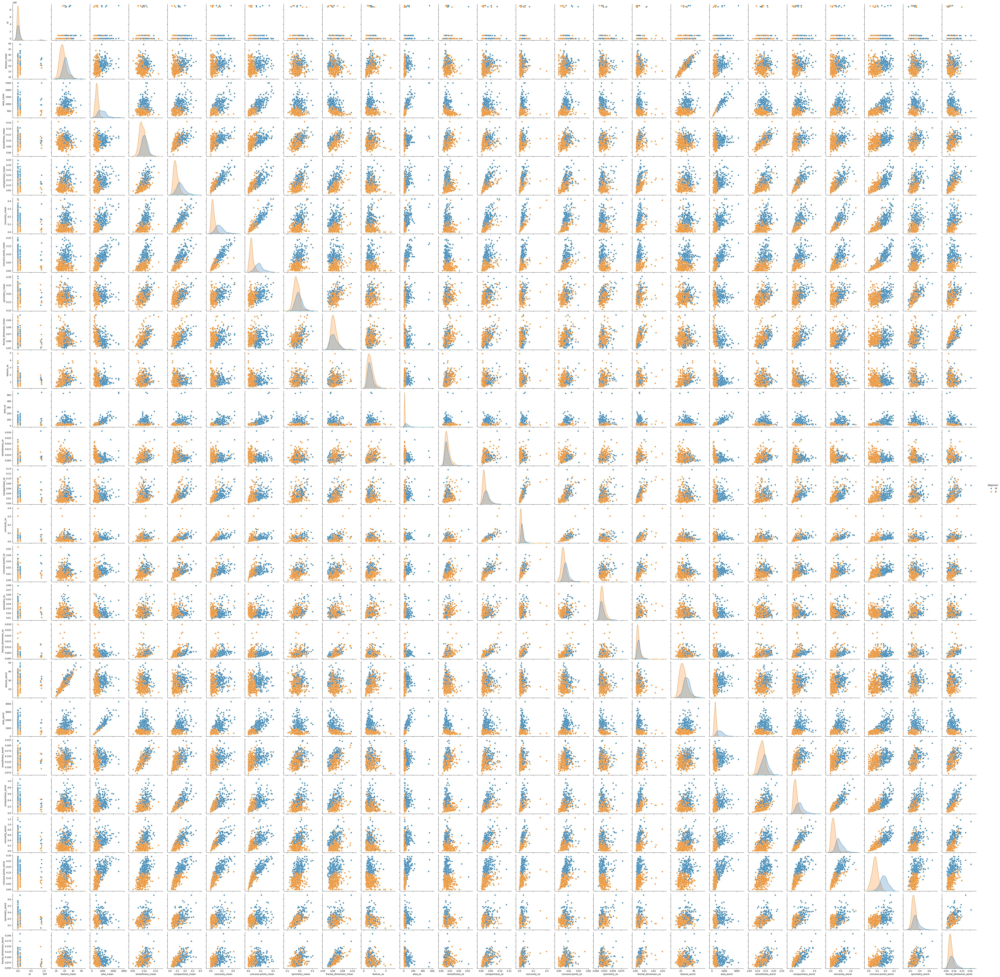

In [19]:
plt.figure(figsize=(15,10))
sns.pairplot(data,hue='diagnosis')

## escalamiento de los datos y Division de data de entrenamiento y test

In [20]:
X_train, X_test, y_train , y_test = train_test_split(X_over, y_over, random_state=42, shuffle=True, test_size= .2)
st_x = StandardScaler()
X_train = st_x.fit_transform(X_train) 
X_test = st_x.transform(X_test)

## Entrenamiento del modelo

In [21]:

model = LogisticRegression()
result = model.fit(X_train, y_train)

# Evaluacion del modelo

In [22]:

prediction_test = model.predict(X_test)
print(metrics.accuracy_score(y_test,prediction_test ))

0.9647058823529412


In [25]:
model.coef_

array([[ 0.46760689,  0.96093062,  0.05570091, -0.26270433,  0.99792741,
         1.35964566, -0.36463789, -0.15332345,  0.09669681,  2.10339518,
         0.20357256, -0.71318827, -0.08765492,  0.55126905, -0.4360001 ,
        -0.68862539,  0.90092497,  1.63407536,  0.19551977, -0.07826258,
         0.71771183,  0.58758731,  0.98572661,  0.52278239]])

# Visualizacion de los pesos de las variables sobre el modelo

Axes(0.125,0.11;0.775x0.77)


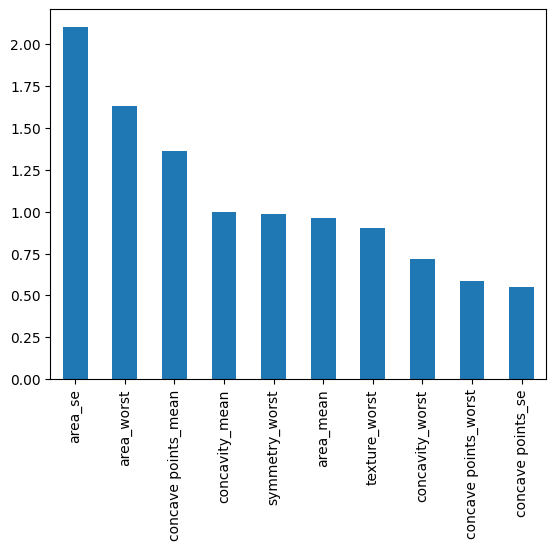

In [27]:
weights = pd.Series(model.coef_[0],
                    index=X_over.columns.values) 
print(weights.sort_values(ascending=False)[:10].plot(kind='bar'))

Axes(0.125,0.11;0.775x0.77)


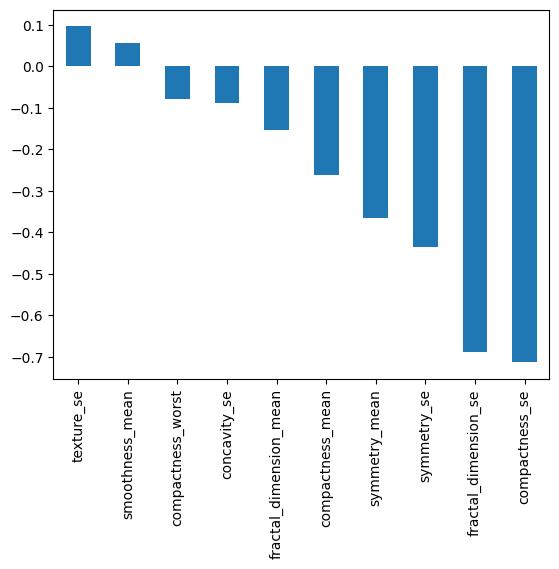

In [28]:
print(weights.sort_values(ascending=False)[-10:].plot(kind='bar'))

# Matriz de confusion

<Figure size 1100x1100 with 0 Axes>

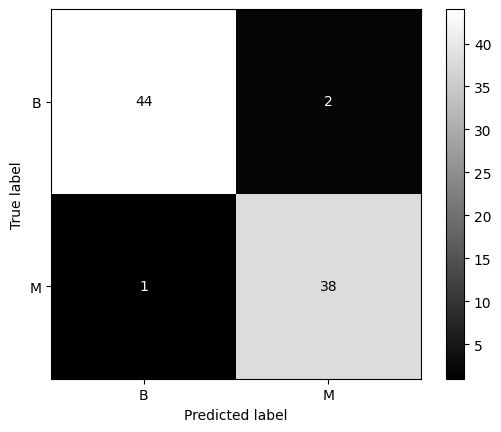

In [23]:
fig = plt.figure(figsize=(11,11))
cm = confusion_matrix(y_test, prediction_test, labels=model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=model.classes_)
disp.plot(cmap='gray')
plt.show()